In [2]:
using LightGraphs
using MatrixNetworks
using VegaDatasets
using DataFrames
using SparseArrays
using LinearAlgebra
using Plots
using VegaLite

In [3]:
airports = dataset("airports")
flightsairport = dataset("flights-airport")

origin,destination,count
"""ABE""","""ATL""",853
"""ABE""","""BHM""",1
"""ABE""","""CLE""",805
"""ABE""","""CLT""",465
"""ABE""","""CVG""",247
"""ABE""","""DTW""",997
"""ABE""","""JFK""",3
"""ABE""","""LGA""",9
"""ABE""","""ORD""",1425
"""ABE""","""PHL""",2


In [4]:
airports

iata,name,city,state,country,latitude,longitude
"""00M""","""Thigpen""","""Bay Springs""","""MS""","""USA""",31.9538,-89.2345
"""00R""","""Livingston Municipal""","""Livingston""","""TX""","""USA""",30.6859,-95.0179
"""00V""","""Meadow Lake""","""Colorado Springs""","""CO""","""USA""",38.9457,-104.57
"""01G""","""Perry-Warsaw""","""Perry""","""NY""","""USA""",42.7413,-78.0521
"""01J""","""Hilliard Airpark""","""Hilliard""","""FL""","""USA""",30.688,-81.9059
"""01M""","""Tishomingo County""","""Belmont""","""MS""","""USA""",34.4917,-88.2011
"""02A""","""Gragg-Wade""","""Clanton""","""AL""","""USA""",32.8505,-86.6115
"""02C""","""Capitol""","""Brookfield""","""WI""","""USA""",43.0875,-88.1779
"""02G""","""Columbiana County""","""East Liverpool""","""OH""","""USA""",40.6733,-80.6414
"""03D""","""Memphis Memorial""","""Memphis""","""MO""","""USA""",40.4473,-92.227


In [5]:
flightsairportdf = DataFrame(flightsairport)

,origin,destination,count
,String,String,Int64
1,ABE,ATL,853
2,ABE,BHM,1
3,ABE,CLE,805
4,ABE,CLT,465
5,ABE,CVG,247
6,ABE,DTW,997
7,ABE,JFK,3
8,ABE,LGA,9
9,ABE,ORD,1425


In [6]:
allairports = vcat(flightsairportdf[!,:origin],flightsairportdf[!,:destination])
uairports = unique(allairports)

305-element Vector{String}:
 "ABE"
 "ABI"
 "ABQ"
 "ABY"
 "ACK"
 "ACT"
 "ACV"
 "ACY"
 "ADK"
 "ADQ"
 "AEX"
 "AGS"
 "AKN"
 ⋮
 "TYR"
 "TYS"
 "VLD"
 "VPS"
 "WRG"
 "WYS"
 "XNA"
 "YAK"
 "YKM"
 "YUM"
 "CYS"
 "OGD"

In [7]:
# create an airports data frame that has a subset of airports that are only included in the routes dataset
airportsdf = DataFrame(airports)
subsetairports = map(i->findfirst(airportsdf[!, :iata].==uairports[i]),1:length(uairports))
airportsdf_subset = airportsdf[subsetairports,:]

,iata,name,city,state,country
,String,String,String,String,String
1,ABE,Lehigh Valley International,Allentown,PA,USA
2,ABI,Abilene Regional,Abilene,TX,USA
3,ABQ,Albuquerque International,Albuquerque,NM,USA
4,ABY,Southwest Georgia Regional,Albany,GA,USA
5,ACK,Nantucket Memorial,Nantucket,MA,USA
6,ACT,Waco Regional,Waco,TX,USA
7,ACV,Arcata,Arcata/Eureka,CA,USA
8,ACY,Atlantic City International,Atlantic City,NJ,USA
9,ADK,Adak,Adak,AK,USA


In [8]:
# build the adjacency matrix
ei_ids = findfirst.(isequal.(flightsairportdf[!,:origin]), [uairports])
ej_ids = findfirst.(isequal.(flightsairportdf[!,:destination]), [uairports])
edgeweights = flightsairportdf[!,:count]
;

In [9]:
A = sparse(ei_ids,ej_ids,1,length(uairports),length(uairports))
A = max.(A,A')

305×305 SparseMatrixCSC{Int64, Int64} with 5668 stored entries:
⠀⠀⣾⠀⠁⡂⡂⠄⡋⢚⢚⣊⢒⢀⠀⠀⠀⢒⠀⢸⡒⡍⠐⣒⠈⠠⡒⢚⢚⠀⠀⠀⠐⡰⠰⠖⠀⡒⠀⠀
⠚⠛⢾⠓⠲⡚⡖⠓⠖⢺⢻⢻⢺⡶⠂⠗⠒⠿⠖⣺⣿⠖⠒⠶⠶⡚⡟⠻⢿⠒⠰⠗⢞⢛⢺⡒⠲⠞⠒⠆
⠡⠠⣸⠢⠪⠂⢧⠰⠷⢺⢹⠸⢸⠰⠲⠢⠁⣻⠄⠸⠷⠇⠒⢿⠾⠀⡷⢻⠾⠇⠸⠷⠴⡸⢺⠸⠤⠇⠂⠁
⠈⠌⢼⠉⢉⡓⠁⠀⡉⢸⢹⣸⢘⡘⠀⠈⠂⢹⡋⢉⠻⡋⠈⢻⢉⢀⡋⢹⠉⠉⠉⠉⢋⢸⠼⠉⠐⠋⠀⠆
⣫⢈⣸⣁⣹⣃⣃⣈⣏⣹⣹⣹⣘⢍⡀⣚⠀⣼⡇⣘⣿⣯⢸⣻⣻⢈⡏⣿⣻⡍⢌⣋⣫⣨⣸⣝⢙⣋⣁⡄
⡺⢰⣿⣒⣓⡒⣓⣲⣗⣺⣺⣺⣛⢒⡒⣖⠒⣻⣂⣒⣻⣿⢚⣳⣺⢲⡗⣿⣲⡒⢒⣖⣚⣐⣲⢚⣐⣛⡒⡒
⠘⢐⢺⡶⢒⡒⣒⠰⡖⢜⢻⢘⢄⠑⠀⡒⠐⣛⣂⢒⣿⡖⢰⣚⣳⠰⣆⢿⢻⣃⣖⣓⡺⢾⢸⢺⢒⡚⠆⠦
⠀⠀⢬⠄⠸⡂⡀⠀⣠⢨⢸⢬⢠⠠⠄⠁⠤⢠⠀⢀⠳⡃⠀⣩⣨⠨⡗⢾⢺⠄⠄⡖⠑⠸⠹⠂⠀⠽⠀⠄
⢠⢀⣼⡄⣥⣠⣌⣀⣀⣤⣼⣠⣴⢠⠀⣃⢀⣴⡀⣼⣤⣢⣠⣤⣀⡀⣧⣼⣤⣄⣀⣀⣤⢠⣸⣤⣀⣤⣀⡀
⣀⣀⣸⣡⣀⡁⡏⢈⣉⢩⢨⢸⢨⢘⠀⢀⣀⣬⡄⣩⣻⣁⢉⣿⡉⠀⣧⣩⣊⡁⣄⣁⣋⢈⣩⣈⣀⣃⡀⡃
⡜⠬⢻⠟⠽⠇⡿⠢⡿⣿⣿⣾⢻⠿⠽⠢⠠⣻⠟⢺⣎⠝⢘⣿⡿⠺⣿⣿⣿⠇⠋⠿⢿⢻⢻⣿⠄⠿⠬⠇
⢰⢠⢸⡄⣼⣄⣦⣀⣶⣲⢾⣰⣰⢲⡄⣠⠀⣾⣧⣴⣶⣴⢠⡶⣶⣐⣗⣾⣶⣦⢤⣦⣶⢰⣸⣲⠠⣶⣆⡀
⠂⡀⣸⠣⠚⠃⠃⢐⡛⢚⢺⣚⢙⡚⡂⡚⠀⠸⠃⠈⣻⡋⢘⢻⢔⠑⡇⣾⣙⡃⠈⣫⢛⣹⢘⠘⠁⢓⠁⠁
⣸⢈⣿⡉⣽⣋⣏⣈⣯⣭⣽⣭⣬⣝⣹⣍⣉⣿⡍⣻⣿⣿⣹⣽⣩⣭⣵⣿⣿⣁⣍⣹⣹⣹⣹⣯⣈⣹⣁⡁
⠚⠐⢻⠓⠾⠇⡇⠀⡟⠾⢸⠺⠿⢲⠚⠖⠀⢿⠎⠸⠿⠟⠸⣿⠷⠸⠟⢻⠾⠃⠓⠻⠟⢺⢼⠓⠚⡗⡀⠂
⠀⠀⢴⠆⢶⡆⡇⠀⡦⢱⢸⢴⢼⢹⢠⠥⠀⢸⠄⢹⣯⡄⠠⣷⡦⣠⣇⣹⣽⡀⠀⡠⢰⢸⢹⡢⠀⢎⠋⠄
⢐⡠⣾⢑⣐⡣⣋⣐⡋⣺⢚⢸⣺⣎⣑⡀⠀⣛⡋⢘⣿⣓⢘⣛⣟⣰⣗⣺⣻⣁⣐⣒⢰⣲⣰⣚⠀⣓⡀⠀
⢰⠆⢺⠲⣚⡒⡖⠃⣖⢾⣸⢚⣲⣒⠳⠂⠒⣾⡃⢺⣿⣶⢲⣺⣒⠐⡷⣾⢶⠓⠳⡲⣰⢺⣺⣾⠂⣲⠗⠓
⢠⠠⣸⠆⠤⠇⡴⠀⡷⢰⣴⢸⣸⠰⣄⡄⠀⣼⠤⢸⣤⡅⢠⣦⢥⢀⣆⣸⢾⠤⡠⢄⢤⢠⢨⣠⠠⠆⠁⡀
⠀⠀⠸⠄⠌⠀⠠⠄⠁⠼⢸⠨⠨⡅⠀⠄⠀⠸⠤⠨⠦⠇⠈⠹⠅⠀⠅⠸⠠⠈⠋⠄⠀⠈⢽⠁⠁⠠⠀⠀

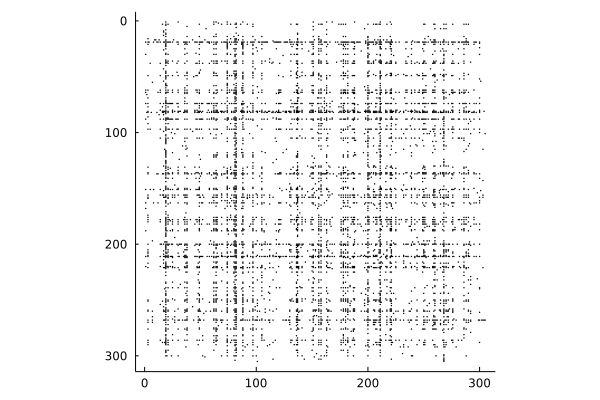

In [10]:
spy(A)

In [11]:
issymmetric(A)

true

There is one popular graphs package in julia and that is the `LightGraphs` package. It does offer a lot of functionality and encourage you to check it out. Nevertheless, the operations we will need here will be basic graph analysis operations and we will make use of the `MatrixNetworks` package. For future reference, and for when you have a "graphs-heavy" project, here's a quick example of how you would build a graph via `LightGraphs`.

In [12]:
L = SimpleGraph(A)

{305, 2834} undirected simple Int64 graph

In [13]:
G=SimpleGraph(10) #SimpleGraph(nnodes,nedges) 
add_edge!(G,7,5)#modifies graph in place.
add_edge!(G,3,5)
add_edge!(G,5,2)

true

For now, we will go back to use the graph's adjacency matrix to perform all the operations we want to perform.

The first is finding the connected components of the graph. Often, it is important to know if the graph you are given is connected specially if you want to later perform diffusion operations on it. Think of it this way: if the graph is disconnected, this means that there is no way for information to travel from one component to another.

#### scomponents

In [14]:
cc = scomponents(A)

MatrixNetworks.Strong_components_output([1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [305], 1, MatrixNetwork{Int64}(305, [1, 13, 15, 56, 57, 60, 61, 67, 70, 71  …  5619, 5626, 5628, 5629, 5656, 5658, 5659, 5665, 5667, 5669], [19, 30, 62, 64, 74, 88, 151, 163, 168, 188  …  115, 143, 156, 158, 221, 268, 81, 268, 101, 268], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1]))

cc.sizes will show the size of each component found. Here, only one component was found and it contains all 305 nodes. This is great, because this means that the graph is connected. 

Next, we will look at the degree distribution of this graph.

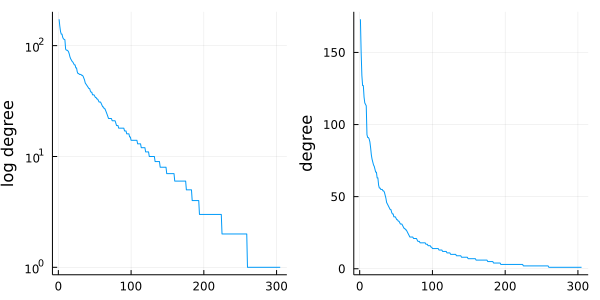

In [15]:
degrees = sum(A,dims=2)[:]
p1 = plot(sort(degrees,rev=true),ylabel="log degree",legend=false,yaxis=:log)
p2 = plot(sort(degrees,rev=true),ylabel="degree",legend=false)
plot(p1,p2,size=(600,300))

This is actually very interesting because it looks like that the airline transportation network seems to fit a powerlaw degree distribution. Knowing that your graph fits a well known model for degree distribution can be very helpful for further studying it. (For instance, there is a lot of literature on graphs that fit power law degree distributions).

Out of curiosity, let's find the airport that has the most connections

In [16]:
maxdegreeid = argmax(degrees)
uairports[maxdegreeid]

"ATL"

In [17]:
us10m = dataset("us-10m")
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill=:lightgray,
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airportsdf_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size={value=10},
    color={value=:steelblue}
)+
@vlplot(
    :rule,
    data=flightsairport,
    transform=[
        {filter={field=:origin,equal=:ATL}},
        {
            lookup=:origin,
            from={
                data=airportsdf_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["origin_latitude", "origin_longitude"]
        },
        {
            lookup=:destination,
            from={
                data=airportsdf_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["dest_latitude", "dest_longitude"]
        }
    ],
    projection={type=:albersUsa},
    longitude="origin_longitude:q",
    latitude="origin_latitude:q",
    longitude2="dest_longitude:q",
    latitude2="dest_latitude:q"
)

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

### 🟡Shortest path problem
Finding the shortest path between two nodes. We will use Dijkstra's algorithm.

In [18]:
ATL_paths = dijkstra(A,maxdegreeid)

([1.0, 2.0, 1.0, 1.0, 2.0, 2.0, 2.0, 1.0, 2.0, 2.0  …  1.0, 1.0, 3.0, 2.0, 1.0, 3.0, 2.0, 2.0, 2.0, 2.0], [19, 82, 19, 19, 151, 82, 270, 19, 17, 17  …  19, 19, 154, 268, 19, 54, 268, 221, 268, 268])

We will find a node that has the longest distance from ATL.

In [19]:
ATL_paths[1][maxdegreeid]

0.0

In [20]:
maximum(ATL_paths[1])

3.0

In [21]:
@show stop1 = argmax(ATL_paths[1])
@show uairports[stop1]
;

stop1 = argmax(ATL_paths[1]) = 123
uairports[stop1] = "GST"


In [22]:
@show stop2 = ATL_paths[2][stop1]
@show uairports[stop2]
;

stop2 = (ATL_paths[2])[stop1] = 152
uairports[stop2] = "JNU"


In [23]:
@show stop3 = ATL_paths[2][stop2]
@show uairports[stop3]
;

stop3 = (ATL_paths[2])[stop2] = 259
uairports[stop3] = "SEA"


In [24]:
@show stop4 = ATL_paths[2][stop3]
@show uairports[stop4]
;

stop4 = (ATL_paths[2])[stop3] = 19
uairports[stop4] = "ATL"


In [25]:
using VegaLite, VegaDatasets

us10m = dataset("us-10m")
airports = dataset("airports")

@vlplot(width=800, height=500) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airportsdf_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size={value=5},
    color={value=:gray}
) +
@vlplot(
    :line,
    data={
        values=[
            {airport=:ATL,order=1},
            {airport=:SEA,order=2},
            {airport=:JNU,order=3},
            {airport=:GST,order=4}
        ]
    },
    transform=[{
        lookup=:airport,
        from={
            data=airports,
            key=:iata,
            fields=["latitude","longitude"]
        }
    }],
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    order={field=:order,type=:ordinal}
)

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

We can look at distances from other airports too, and put the whole thing in a function.

In [26]:
nodeid = argmin(degrees)
@show uairports[nodeid]
d = dijkstra(A,nodeid)
argmax(d[1]),uairports[argmax(d[1])]

uairports[nodeid] = "ABY"


(123, "GST")

In [27]:
function find_path(d,id)
    shortestpath = zeros(Int,1+Int.(d[1][id]))
    shortestpath[1] = id
    for i = 2:length(shortestpath)
        shortestpath[i] = d[2][shortestpath[i-1]]
    end
    return shortestpath
end
p = find_path(d,123)
uairports[p]

5-element Vector{String}:
 "GST"
 "JNU"
 "ANC"
 "ATL"
 "ABY"

### 🟡Minimum Spanning Tree (MST)
The next problem is forming a minimum spanning tree on the graph. The idea of a minimum spanning tree is to connect all nodes in the graph with as little edges as possible. We will use Prim's algorithm for this problem.

In [28]:
?mst_prim

search: mst_prim mst_prim_matrix



## MST_PRIM

```
compute a minimum spanning tree with Prim's algorithm.
T = mst_prim_matrix(A) computes a minimum spanning tree T using Prim's algorithm
for the spanning tree of a graph with non-negative edge weights.

T = mst_prim_matrix(A,false) produces an MST for just the component at A containing
vertex 1.  T = mst_prim_matrix(A,0,u) produces the MST for the component
containing vertex u.

(ti,tj,tv,nverts) = mst_prim(A) returns the edges from the matrix and does not
convert to a sparse matrix structure.  This saves a bit of work and is
required when there are 0 edge weights.
```

## Functions

  * (ti,tj,tv,nverts) = mst_prim(A::MatrixNetwork,full::Bool,u::Int64)
  * (ti,tj,tv,nverts) = mst_prim(A::MatrixNetwork)
  * (ti,tj,tv,nverts) = mst_prim{T}(A::SparseMatrixCSC{T,Int64},full::Bool,u::Int64)
  * (ti,tj,tv,nverts) = mst_prim{T}(A::SparseMatrixCSC{T,Int64})
  * T = mst*prim*matrix(A::MatrixNetwork,full::Bool,u::Int64) #output modifier
  * T = mst*prim*matrix(A::MatrixNetwork) #output modifier
  * T = mst*prim*matrix{T}(A::SparseMatrixCSC{T,Int64},full::Bool,u::Int64) #output modifier
  * T = mst*prim*matrix{T}(A::SparseMatrixCSC{T,Int64}) #output modifier

## Example

```
A = load_matrix_network("airports")
A = -A #convert to travel time
A = max.(A,A')
A = sparse(A)
(ti,tj,tv,nverts) = mst_prim(A)
```


In [29]:
ti,tj,tv,nverts = mst_prim(A)

([2, 3, 4, 5, 6, 7, 8, 9, 10, 11  …  296, 297, 298, 299, 300, 301, 302, 303, 304, 305], [66, 286, 19, 151, 82, 197, 19, 17, 17, 19  …  19, 182, 231, 268, 141, 54, 268, 156, 268, 101], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 305)

We will form a new DataFrame with a new set of edges (from the MST)

In [30]:
df_edges = DataFrame(:ei=>uairports[ti],:ej=>uairports[tj])

,ei,ej
,String,String
1,ABI,CMI
2,ABQ,TPA
3,ABY,ATL
4,ACK,JFK
5,ACT,DFW
6,ACV,MRY
7,ACY,ATL
8,ADK,ANC
9,ADQ,ANC


In [31]:
@vlplot(width=800, height=500) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airportsdf_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size={value=20},
    color={value=:gray}
) +
@vlplot(
    :rule,
    data=df_edges, #data=flightsairport,
    transform=[
        {
            lookup=:ei,
            from={
                data=airportsdf_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["originx", "originy"]
        },
        {
            lookup=:ej,
            from={
                data=airportsdf_subset,
                key=:iata,
                fields=["latitude", "longitude"]
            },
            as=["destx", "desty"]
        }
    ],
    projection={type=:albersUsa},
    longitude="originy:q",
    latitude="originx:q",
    longitude2="desty:q",
    latitude2="destx:q"
)

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

### 🟡PageRank
PageRank is the algorithm that got Google started. The idea is: given an network of connections between multiple nodes (web pages in the cae of Google), is there a way to return a list of ranked nodes? PageRank provides this ranking. Obviously, nodes can be ranked in several different ways but PageRank remains to be one of the most popular methods in network analysis. Let's check out the documentation of `pagerank` below.

In [32]:
?MatrixNetworks.pagerank

## `pagerank`

PageRank is the stationary distribution of a Markov chain defined as follows. The behavior of the chain at state i is: 

  * with probability $lpha$, randomly transition to an out-neighbor of the current node (based on a weighted probabilities if the graph has non-negative weights).
  * with probability $1-lpha$, jump to a random node chosen anywhere in the network.
  * if there are no out-neighbors, then jump anywhere in the network  with equal probability.

The solution satisfies a linear system of equations. This function will solve that linear system to a 1-norm error of `tol` where `tol` is chosen by default to be the machine precision. 

The solution is always a probability distribution.        

## Functions

  * `x = pagerank(A::SparseMatrixCSC{V,Int},alpha::Float64)`
  * `x = pagerank(A::MatrixNetwork{V},alpha::Float64)`
  * `x = pagerank(A,alpha,eps::Float64)` specifies solution tolerance too.

## Inputs

  * `A`: The sparse matrix or matrix network that you wish to use to compute PageRank. In the case of a sparse matrix, it must have non-negative values and the values will impact the  computation as we will compute a stochastic normalization  as part of the algorithm.
  * `alpha`: the teleportation parameter given above.
  * `tol`: the tolerance, the default choice is machine precision  for floating point, which is more than enough for almost all  applications.

## Examples

```
pagerank(A,alpha) 
            # return the standard PageRank vector 
            # with uniform teleportation and alpha=0.85 
            # computed to machine precision            
```


Now, we will run PageRank on our adjacency matrix `A`.

In [33]:
v = MatrixNetworks.pagerank(A,0.85)

305-element Vector{Float64}:
 0.0020923348051623326
 0.0009436892155004145
 0.006119901015186467
 0.0006607117011710984
 0.0008603728281911192
 0.0006445871130434956
 0.0015924822798577083
 0.0009129198498983633
 0.0007673129766872152
 0.0007673129766872152
 0.0009549149040574479
 0.0010558743385657198
 0.0013344573507603737
 ⋮
 0.0006445871130434956
 0.0027593013724303977
 0.0006607117011710984
 0.001475388547065869
 0.0017187137444043738
 0.0006494983427307581
 0.0043517606900941854
 0.0016096866743709605
 0.0006494983427307581
 0.0015555904158222685
 0.0007866027711239782
 0.0008103673010237374

Here, note that the return vector `v` sums to `1`.

In [34]:
sum(v)

0.9999999999999999

In [35]:
insertcols!(airportsdf_subset,7,:pagerank_value=>v)

,iata,name,city,state,country
,String,String,String,String,String
1,ABE,Lehigh Valley International,Allentown,PA,USA
2,ABI,Abilene Regional,Abilene,TX,USA
3,ABQ,Albuquerque International,Albuquerque,NM,USA
4,ABY,Southwest Georgia Regional,Albany,GA,USA
5,ACK,Nantucket Memorial,Nantucket,MA,USA
6,ACT,Waco Regional,Waco,TX,USA
7,ACV,Arcata,Arcata/Eureka,CA,USA
8,ACY,Atlantic City International,Atlantic City,NJ,USA
9,ADK,Adak,Adak,AK,USA


In [36]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airportsdf_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size="pagerank_value:q",
    color={value=:steelblue}
)

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

### 🟡Clustering Coefficients
From Wikipedia: The local clustering coefficient of a vertex (node) in a graph quantifies how close its neighbours are to being a clique (complete graph).

This means that if for example, a node is connected to two nodes that are also connected to each other, that node's clustering coeefficient is 1. This can be a good metric to find out which nodes tend to have tight clusters around them. Let's look at the documentation of `clustercoeffs` from MatrixNetworks.

In [37]:
?clustercoeffs

search: clustercoeffs dirclustercoeffs global_clustering_coefficient



## CLUSTERCOEFFS

```
compute undirected clustering coefficients for a graph. clustercoeffs(A) computes a 
normalized, weighted clustering coefficients from a graph represented by a symmetric 
adjacency matrix A. clustercoeffs(A,weighted,normalized), with weighted and normalized 
boolean values indicating whether the computation has to be weighted and/or normalized.
```

## Functions

  * cc = clustercoeffs(A::MatrixNetwork,weighted::Bool,normalized::Bool)
  * cc = clustercoeffs{T}(A::SparseMatrixCSC{T,Int64},weighted::Bool,normalized::Bool)

If weighted and normalized are not specified, they are understood as true

## Example

```
A = load_matrix_network("clique-10")    
cc = clustercoeffs(MatrixNetwork(A))    
```


In [38]:
cc = clustercoeffs(A)
cc[findall(cc.<=eps())] .= 0
cc

305-element Vector{Float64}:
 0.8333333333333334
 1.0
 0.6475609756097561
 0.0
 0.6666666666666666
 0.0
 0.5333333333333333
 1.0
 0.0
 0.0
 1.0
 1.0
 1.0
 ⋮
 0.0
 0.9779411764705882
 0.0
 1.0
 0.0
 0.0
 0.5897435897435898
 0.0
 0.0
 0.6666666666666666
 1.0
 1.0

In [39]:
insertcols!(airportsdf_subset,7,:ccvalues=>cc)

,iata,name,city,state,country
,String,String,String,String,String
1,ABE,Lehigh Valley International,Allentown,PA,USA
2,ABI,Abilene Regional,Abilene,TX,USA
3,ABQ,Albuquerque International,Albuquerque,NM,USA
4,ABY,Southwest Georgia Regional,Albany,GA,USA
5,ACK,Nantucket Memorial,Nantucket,MA,USA
6,ACT,Waco Regional,Waco,TX,USA
7,ACV,Arcata,Arcata/Eureka,CA,USA
8,ACY,Atlantic City International,Atlantic City,NJ,USA
9,ADK,Adak,Adak,AK,USA


In [40]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill="#eee",
        stroke=:white
    },
    data={
        values=us10m,
        format={
            type=:topojson,
            feature=:states
        }
    },
    projection={type=:albersUsa},
) +
@vlplot(
    :circle,
    data=airportsdf_subset,
    projection={type=:albersUsa},
    longitude="longitude:q",
    latitude="latitude:q",
    size="ccvalues:q",
    color={value=:gray}
)

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

TypeError: Cannot read property 'length' of undefined
    at expression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:91:19)
    at Object.operator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:111:30)
    at Context.operatorExpression (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:647:24)
    at Context.parseOperator (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:196:44)
    at C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view\node_modules\vega-runtime\build\vega-runtime.js:29:36
    at Array.forEach (<anonymous>)
    at Context.parse (C:\Users\CaioSainVallio\.julia\packages\VegaLite\sHyyT\deps\node_modules\vega-view

# Finally...
After finishing this notebook, you should be able to:
- [ ] take a list of connections between nodes and form an adjacency matrix out of them
- [ ] use the LightGraphs package to create a graph
- [ ] detect if a graph is connected or not
- [ ] solve the shortest path problem on a graph and a given node
- [ ] solve the minimum spanning tree problem on a graph
- [ ] solve the PageRank problem on a graph
- [ ] find the clustering coefficients of nodes in a graph

# 🥳 One cool finding

We ran PageRank (which is a common algorithm to rank nodes in a network), and visualized the PageRank values on the US airports. The results agreed with the hypothesis that known hubs have higher PageRank value. Look at Atlanta, it's actually the biggest.

<img src="data/0801.png" width="600">
